# Skin Disease Prediction through Image Analysis of Diverse Skin Tones

--- 

# Part 2: Image Pre-Processing/Modeling

This section contains image pre-processing and modeling for a binary classification problem (benign vs malignant). The images were pre-processed using Keras ImageDataGenerator. The images were pre-processed in two separate ways to be ran through different models to test model performance. In one group a pre-processing function that matched how my pre-trained model (ResNet50) was processed was used. In the another group the pre-processing function was omited and the images were just scaled. The training set in both groups also had image augmentation applied after having an initial severely overfit model. This helped all additional models to be less overfit. Image augmentation was not applied to the validation or testing sets. 

Upwards of 50 different models were ran over the pre-trained Keras ResNet50 model, with each model being tuned differently to improve the results. The following 7 models were the models that performed best, with model 6 being the top performing model. You will see in the following code that originally I thought model 2 was the best model. Upon analyzing the image predictions with their corresponding confidence intervals below, I learned that I had made a mistake in implementing the final output layer on models 1-5, skewing the results and interpretability of the models. As a result, models 6 and 7 were ran with the final output layer activation parameters changed to "softmax" over "sigmoid." As this is a medical image classification problem, recall was being optimized. As a result, model 6 was chosen to be the best model because false negatives were being minimized slightly more than false positives. Corrosponding image predictions with their confidence intervals can be found below. 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
import shutil
import os 
import dask.bag as db
import pickle
import cv2

from dask.diagnostics import ProgressBar
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten, GlobalAveragePooling2D 
from tensorflow.keras import utils
from keras.applications.densenet import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
from keras.applications import ResNet50
from sklearn.metrics import ConfusionMatrixDisplay, plot_confusion_matrix, confusion_matrix, plot_roc_curve, classification_report

In [2]:
#read in csv
train=pd.read_csv('/content/drive/MyDrive/DSI/train.csv')
val=pd.read_csv('/content/drive/MyDrive/DSI/val.csv')
test=pd.read_csv('/content/drive/MyDrive/DSI/test.csv')

## All functions used in this notebook can be found in the following cell:

In [17]:
#function to copy images into new folders 
def move_images(lst, source_path, destination_path):
  for image in lst:
    shutil.move(f'{source_path}/{image}', destination_path)

#plotting batch images to form a grid. function modified from tensorflow 
def plot_images(images_array):
   fig, axes = plt.subplots(1,16, figsize=(20,20))
   axes=axes.flatten()
   for img, ax in zip(images_array, axes):
     ax.imshow(img)
     ax.axis('off')
   plt.tight_layout()
   plt.show()

#function to plot predictions at confidance interval. function modified from nuevo foundation 
def plot_post_image(i, predictions_array, true_label, img):
  true_label, img = true_label[i], img[i]
  plt.grid(False)
  plt.xticks([])
  plt.yticks([])

  plt.imshow(img, cmap=plt.cm.binary)

  predicted_label = np.argmax(predictions_array, axis=0)
  if predicted_label == true_label:
    color = 'blue'
  else:
    color = 'red'

  plt.xlabel("{} {:2.0f}% ({})".format(class_names[predicted_label],
                                100*np.max(predictions_array),
                                class_names[true_label]),
                                color=color)

## Data Manipulation to Prep for Pre-Processing

Here, data was manipulated in order to move all images into the correct directories to use the Keras ImageDataGenerator class to pre-process the data. In order to use this class, images must be in a subdirectory separated by each class, with the parent directory of the set (either training, validation or testing). 

In [3]:
#filter to seperate malignant from benign 
train_malignant=train.loc[train['malignant']==1]
train_benign=train.loc[train['malignant']==0]
val_malignant=val.loc[val['malignant']==1]
val_benign=val.loc[val['malignant']==0]
test_malignant=test.loc[test['malignant']==1]
test_benign=test.loc[test['malignant']==0]

#shape
print(train_malignant.shape)
print(train_benign.shape)
print(val_malignant.shape)
print(val_benign.shape)
print(test_malignant.shape)
print(test_benign.shape)

(118, 7)
(333, 7)
(33, 7)
(97, 7)
(17, 7)
(48, 7)


In [4]:
#image paths
train_source_path='/content/drive/MyDrive/DSI/train_ddi'
val_source_path='/content/drive/MyDrive/DSI/val_ddi'
test_source_path='/content/drive/MyDrive/DSI/test_ddi'
train_malignant_destination_path='/content/drive/MyDrive/DSI/train_ddi/train_malignant/'
train_benign_destination_path='/content/drive/MyDrive/DSI/train_ddi/train_benign/'
val_malignant_destination_path='/content/drive/MyDrive/DSI/val_ddi/val_malignant/'
val_benign_destination_path='/content/drive/MyDrive/DSI/val_ddi/val_benign/'
test_malignant_destination_path='/content/drive/MyDrive/DSI/test_ddi/test_malignant/'
test_benign_destination_path='/content/drive/MyDrive/DSI/test_ddi/test_benign/'

In [5]:
#making lists of all files 
train_malignant_lst=train_malignant['DDI_file'].to_list()
train_benign_lst=train_benign['DDI_file'].to_list()
val_malignant_lst=val_malignant['DDI_file'].to_list()
val_benign_lst=val_benign['DDI_file'].to_list()
test_malignant_lst=test_malignant['DDI_file'].to_list()
test_benign_lst=test_benign['DDI_file'].to_list()

In [ ]:
#this line is commented out after being ran once and does not need to re-run 

# #apply 'move_images' function (test)
# move_images(train_malignant_lst, train_source_path, train_malignant_destination_path)

In [ ]:
#this line is commented out after being ran once and does not need to re-run 

# #apply function to remaining categories 
# move_images(train_benign_lst, train_source_path, train_benign_destination_path)
# move_images(val_malignant_lst, val_source_path, val_malignant_destination_path)
# move_images(val_benign_lst, val_source_path, val_benign_destination_path)
# move_images(test_malignant_lst, test_source_path, test_malignant_destination_path)
# move_images(test_benign_lst, test_source_path, test_benign_destination_path)

---

## Image Pre-Processing

In this section the keras ImageDataGenerator class was used to pre-process the images for modeling. Image pre-processing was broken up into two groups: 


1.   Utilizing a ResNet50 pre-processing function, with rescaling 
2.   Only rescaling, no pre-processing function

Batch size was initially selected at 32, but was lowered to 16 after experiencing machine crashing issues. After running an initially severely overfit model, data augmentation was applied to only the training sets for both above groups. An image size of 512x512 was selected to resize each image. Training batches were shuffled, while validation and test batches remained unshuffled for interpretability. 

A batch from each group was plotted as seen below. These plots show visually how different pre-processing changed the data input for the models. 

Finally, this section also contains some test image analysis prep to be used when analyzing model output below. 

In [7]:
#Pre-processing using ResNet50 Preprocessing Function 
#appling ImageDataGenerator to pre-process image 
#after running overfit model, image augmentation was included on train 

train_batches=ImageDataGenerator(rescale= 1./255, preprocessing_function=tf.keras.applications.resnet50.preprocess_input, rotation_range=40, width_shift_range=0.2,
                                 height_shift_range=0.2, shear_range=0.2, zoom_range=0.2, horizontal_flip=True).flow_from_directory(
                                     directory=train_source_path, 
                                     target_size=(512,512), 
                                     classes=['benign', 'malignant'], 
                                     batch_size=16, 
                                     shuffle=True)
val_batches=ImageDataGenerator(rescale=1./255, preprocessing_function=tf.keras.applications.resnet50.preprocess_input).flow_from_directory(
    directory=val_source_path, 
    target_size=(512,512), 
    classes=['benign', 'malignant'], 
    batch_size=16, 
    shuffle=False)
test_batches=ImageDataGenerator(rescale=1./255, preprocessing_function=tf.keras.applications.resnet50.preprocess_input).flow_from_directory(
    directory=test_source_path, 
    target_size=(512,512), 
    classes=['benign', 'malignant'],
    batch_size=16, 
    shuffle=False)


Found 451 images belonging to 2 classes.
Found 130 images belonging to 2 classes.
Found 65 images belonging to 2 classes.


In [ ]:
  #creating variables for train batch images and their respective labels
  imgs, labels=next(train_batches)

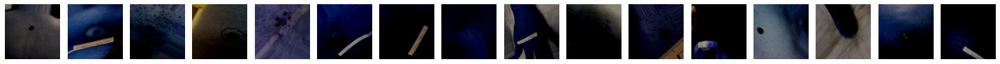

[[1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]]


In [ ]:
  #calling plot_images function, printing corrosponding labels (including Keras preprocessing function)
  plot_images(imgs)
  print(labels)

#### Removing Keras Pre-Processing Function

In [9]:
#removing pre-processing function to see how model performs 
#appling ImageDataGenerator to preprocess image 
#after running overfit model, image augmentation was included on train 
#removing pre-processing function to see how model performs 

train_batches_nopre=ImageDataGenerator(rescale= 1./255, rotation_range=40, width_shift_range=0.2,
                                 height_shift_range=0.2, shear_range=0.2, zoom_range=0.2, horizontal_flip=True).flow_from_directory(
                                     directory=train_source_path, 
                                     target_size=(512,512), 
                                     classes=['benign', 'malignant'], 
                                     batch_size=16, 
                                     shuffle=True)
val_batches_nopre=ImageDataGenerator(rescale=1./255).flow_from_directory(
    directory=val_source_path, 
    target_size=(512,512), 
    classes=['benign', 'malignant'], 
    batch_size=16, 
    shuffle=False)
test_batches_nopre=ImageDataGenerator(rescale=1./255).flow_from_directory(
    directory=test_source_path, 
    target_size=(512,512), 
    classes=['benign', 'malignant'],
    batch_size=16, 
    shuffle=False)

Found 451 images belonging to 2 classes.
Found 130 images belonging to 2 classes.
Found 65 images belonging to 2 classes.


In [ ]:
#creating variables for train images and labels with no pre-processing function (just scaled)
imgs_nopre, labels_nopre=next(train_batches_nopre)

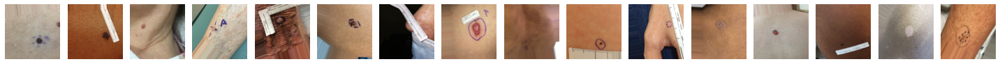

[[1. 0.]
 [1. 0.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]
 [1. 0.]
 [0. 1.]
 [1. 0.]]


In [ ]:
  #calling plot_images function, printing respective labels 
  plot_images(imgs_nopre)
  print(labels_nopre)

#### The following 4 blocks of code are test set analysis prep to be used when interpreting model output below

In [10]:
#creating test batch images for later predictions/analysis 
test_imgs, test_labels=next(test_batches)
test_imgs_nopre, test_labels_nopre=next(test_batches_nopre)

In [11]:
#Creating a generator with all images (1 batch) for analysis after modeling
test_images_analysis=ImageDataGenerator(rescale=1./255).flow_from_directory(
    directory=test_source_path, 
    target_size=(512,512), 
    classes=['benign', 'malignant'],
    batch_size=65, 
    shuffle=False)

Found 65 images belonging to 2 classes.


In [12]:
#creating test set image and label variables 
test_imgs_analysis, test_labels_analysis= next(test_images_analysis)

In [13]:
#y_test labels for analysis (different pre processing)
y_test_labels=test_batches_nopre.labels
y_test=test_batches.labels

--- 

## Model Training

## Model 1: 

Model 1 was overfit. All pre-trained layers were frozen. Adam optimizer was used with a learning_rate of 0.0001. Accuracy and Recall were both monitored during model training. Results can be found below. 

In [ ]:
#implement pre-built keras network 
conv_base=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base.layers:
  layer.trainable=False

#adding single layer on top of pre-built network 
conv_base = Sequential()
conv_base.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base.add(Dense(2, activation='sigmoid'))

#compile model 
conv_base.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history = conv_base.fit(train_batches, 
                               validation_data = val_batches, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

94765736/94765736 [==============================] - 0s 0us/step
Epoch 1/50
28/28 [==============================] - 98s 3s/step - loss: 2.2187 - accuracy: 0.7218 - recall: 0.6713 - val_loss: 1.3722 - val_accuracy: 0.7578 - val_recall: 0.0234
Epoch 2/50
28/28 [==============================] - 36s 1s/step - loss: 1.1606 - accuracy: 0.7954 - recall: 0.7609 - val_loss: 2.1552 - val_accuracy: 0.2812 - val_recall: 0.0000e+00
Epoch 3/50
28/28 [==============================] - 35s 1s/step - loss: 0.9188 - accuracy: 0.8322 - recall: 0.8092 - val_loss: 0.9799 - val_accuracy: 0.7578 - val_recall: 0.0234
Epoch 4/50
28/28 [==============================] - 36s 1s/step - loss: 0.7194 - accuracy: 0.8575 - recall: 0.8345 - val_loss: 0.7275 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 5/50
28/28 [==============================] - 36s 1s/step - loss: 0.5619 - accuracy: 0.8943 - recall: 0.8621 - val_loss: 0.7575 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 6/50
28/28 [=======================

In [ ]:
#evaluate val 
conv_base.evaluate(val_batches)

#evaluate test
conv_base.evaluate(test_batches)

#save model 
conv_base.save('/content/drive/MyDrive/DSI/01_model')

5/5 [==============================] - 11s 3s/step - loss: 1.9553 - accuracy: 0.8000 - recall: 0.8000


## Model 2:

To combat the first model being overfit, l2 regularization was applied to model 2. The SGD optimizer was used over Adam with a learning rate of 0.0001 and momentum of 0.9. This model was originally what I deemed the best model, but learned there was an error in execution by using a sigmoid activation function over softmax. This led to flaws in interpretability for a binary classification problem as the confidence intervals in the plotted predictions were not intuitive. Results can be found below.

In [ ]:
#implement pre-built keras network 
conv_base2=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

# adding regularization
regularizer = tf.keras.regularizers.l2(0.0001)

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base2.layers:
  layer.trainable=False
  for attr in ['kernel_regularizer']:
        if hasattr(layer, attr):
          setattr(layer, attr, regularizer)

#adding single layer on top of pre-built network 
conv_base2 = Sequential()
conv_base2.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base2.add(Dense(2, activation='sigmoid'))

#compile model 
conv_base2.compile(optimizer = tf.keras.optimizers.SGD(learning_rate=0.0001, momentum=0.9), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history2 = conv_base2.fit(train_batches, 
                               validation_data = val_batches, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

Epoch 1/50
28/28 [==============================] - 42s 1s/step - loss: 2.6564 - accuracy: 0.6989 - recall_4: 0.6437 - val_loss: 1.3562 - val_accuracy: 0.2734 - val_recall_4: 0.2734
Epoch 2/50
28/28 [==============================] - 35s 1s/step - loss: 1.8793 - accuracy: 0.7149 - recall_4: 0.6920 - val_loss: 2.1261 - val_accuracy: 0.4219 - val_recall_4: 1.0000
Epoch 3/50
28/28 [==============================] - 36s 1s/step - loss: 2.0133 - accuracy: 0.7356 - recall_4: 0.7287 - val_loss: 1.7667 - val_accuracy: 0.2578 - val_recall_4: 0.9844
Epoch 4/50
28/28 [==============================] - 35s 1s/step - loss: 1.3131 - accuracy: 0.7770 - recall_4: 0.7471 - val_loss: 2.5279 - val_accuracy: 0.2422 - val_recall_4: 0.2969
Epoch 5/50
28/28 [==============================] - 36s 1s/step - loss: 1.1068 - accuracy: 0.8184 - recall_4: 0.7609 - val_loss: 3.4370 - val_accuracy: 0.2422 - val_recall_4: 1.0000
Epoch 6/50
28/28 [==============================] - 36s 1s/step - loss: 0.9705 - accuracy:

In [ ]:
#evaluate val 
conv_base2.evaluate(val_batches)

#evaluate test
conv_base2.evaluate(test_batches)

#save model 
conv_base2.save('/content/drive/MyDrive/DSI/02_model')

5/5 [==============================] - 2s 300ms/step - loss: 1.0779 - accuracy: 0.8615 - recall_4: 0.8000


In [ ]:
conv_base2 = tf.keras.models.load_model('/content/drive/MyDrive/DSI/02_model')

5/5 [==============================] - 2s 332ms/step


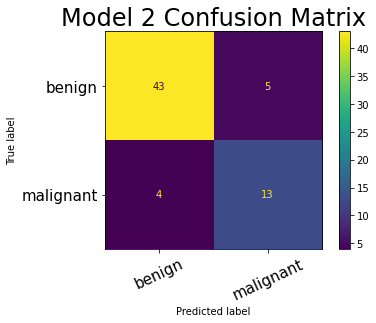

In [ ]:
#test predictions 
preds_02 = conv_base2.predict(test_batches)
predicted_classes_02 = np.argmax(preds_02, axis=1)

#confusion matrix 
cm_02=confusion_matrix(y_test, predicted_classes_02)

#plot confusion matrix
display_cm02 = ConfusionMatrixDisplay(cm_02, display_labels=['benign', 'malignant'])
display_cm02.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 2 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [ ]:
#classification report 
print(classification_report(y_test, predicted_classes_02, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.91      0.90      0.91        48
   malignant       0.72      0.76      0.74        17

    accuracy                           0.86        65
   macro avg       0.82      0.83      0.82        65
weighted avg       0.86      0.86      0.86        65



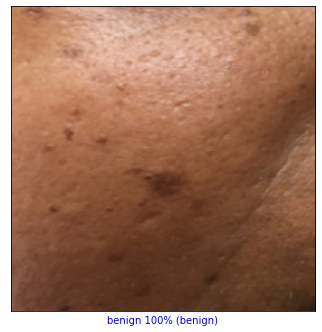

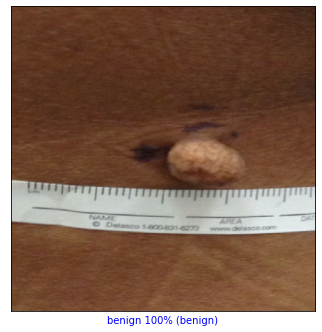

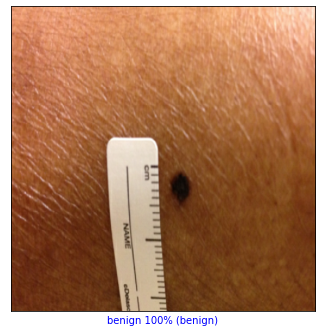

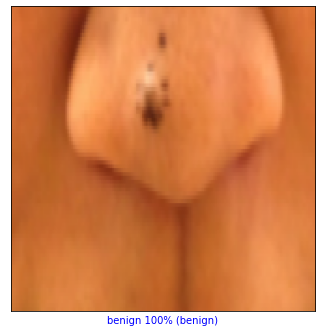

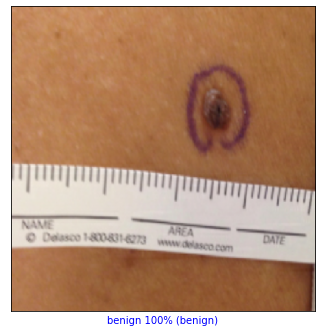

...

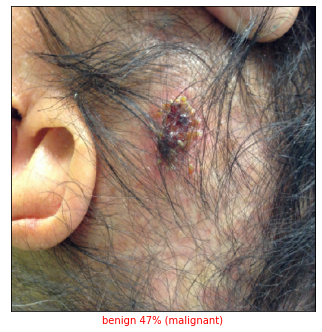

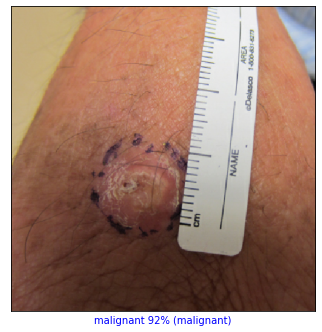

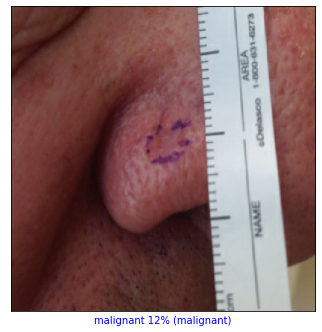

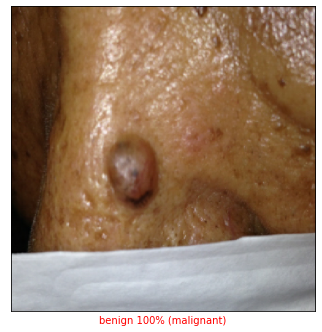

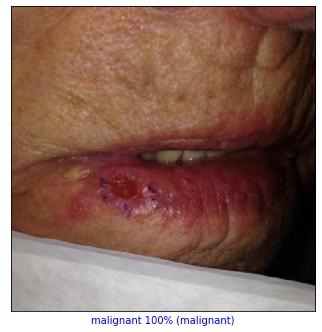

In [ ]:
class_names=['benign', 'malignant']

#calling function 
for i in range(0, len(preds_02+1)):   
  plt.figure(figsize=(12,8))
  plt.subplot(1,2,1)
  plot_post_image(i, preds_02[i], y_test, test_imgs_analysis)
  plt.show()

---

## Model 3:

Model 3 had all of the same parameters as model 2 above, but the data input in the model did not contain the keras pre-processing function. The model performance suffered as a result. Results are shown below. 

In [ ]:
#implement pre-built keras network 
conv_base3=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

# adding regularization
regularizer = tf.keras.regularizers.l2(0.0001)

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base3.layers:
  layer.trainable=False
  for attr in ['kernel_regularizer']:
        if hasattr(layer, attr):
          setattr(layer, attr, regularizer)

#adding single layer on top of pre-built network 
conv_base3 = Sequential()
conv_base3.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base3.add(Dense(2, activation='sigmoid'))

#compile model 
conv_base3.compile(optimizer = tf.keras.optimizers.SGD(learning_rate=0.0001, momentum=0.9), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history3 = conv_base3.fit(train_batches_nopre, 
                               validation_data = val_batches_nopre, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

Epoch 1/50
28/28 [==============================] - 41s 1s/step - loss: 3.5092 - accuracy: 0.6529 - recall_5: 0.6299 - val_loss: 1.9628 - val_accuracy: 0.2891 - val_recall_5: 0.0000e+00
Epoch 2/50
28/28 [==============================] - 36s 1s/step - loss: 1.9049 - accuracy: 0.7287 - recall_5: 0.6621 - val_loss: 1.1675 - val_accuracy: 0.7578 - val_recall_5: 0.0938
Epoch 3/50
28/28 [==============================] - 35s 1s/step - loss: 1.5849 - accuracy: 0.7471 - recall_5: 0.7264 - val_loss: 2.7323 - val_accuracy: 0.7344 - val_recall_5: 0.0000e+00
Epoch 4/50
28/28 [==============================] - 35s 1s/step - loss: 1.4371 - accuracy: 0.7494 - recall_5: 0.7126 - val_loss: 0.7742 - val_accuracy: 0.6484 - val_recall_5: 0.9297
Epoch 5/50
28/28 [==============================] - 36s 1s/step - loss: 1.6130 - accuracy: 0.7241 - recall_5: 0.7310 - val_loss: 1.6173 - val_accuracy: 0.7578 - val_recall_5: 0.7578
Epoch 6/50
28/28 [==============================] - 35s 1s/step - loss: 0.9918 - a

In [ ]:
#evaluate val 
conv_base3.evaluate(val_batches_nopre)

#evaluate test
conv_base3.evaluate(test_batches_nopre)

#save model 
conv_base3.save('/content/drive/MyDrive/DSI/03_model')

5/5 [==============================] - 2s 279ms/step - loss: 1.9899 - accuracy: 0.7692 - recall_5: 0.8154


5/5 [==============================] - 2s 328ms/step


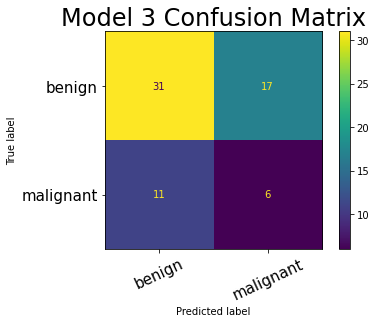

In [ ]:
#test predictions 
preds_03 = conv_base3.predict(test_batches)
predicted_classes_03 = np.argmax(preds_03, axis=1)

#confusion matrix 
cm_03=confusion_matrix(y_test_labels, predicted_classes_03)

#plot confusion matrix
display_cm03 = ConfusionMatrixDisplay(cm_03, display_labels=['benign', 'malignant'])
display_cm03.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 3 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [ ]:
#classification report 
print(classification_report(y_test_labels, predicted_classes_03, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.74      0.65      0.69        48
   malignant       0.26      0.35      0.30        17

    accuracy                           0.57        65
   macro avg       0.50      0.50      0.49        65
weighted avg       0.61      0.57      0.59        65



---

## Model 4:

Model 4 utilized l2 regularization to combat being overfit. The optimizer for this model was Adam with a learning rate of 0.0001. The data input into this model did not contain a keras pre-processing function. Results are shown below. 

In [ ]:
#implement pre-built keras network 
conv_base4=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

# adding regularization
regularizer = tf.keras.regularizers.l2(0.001)

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base4.layers:
  layer.trainable=False
  for attr in ['kernel_regularizer']:
        if hasattr(layer, attr):
          setattr(layer, attr, regularizer)

#adding single layer on top of pre-built network 
conv_base4 = Sequential()
conv_base4.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base4.add(Dense(2, activation='sigmoid'))

#compile model 
conv_base4.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history4 = conv_base4.fit(train_batches_nopre, 
                               validation_data = val_batches_nopre, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

Epoch 1/50
28/28 [==============================] - 41s 1s/step - loss: 2.1769 - accuracy: 0.6621 - recall_8: 0.6575 - val_loss: 0.6712 - val_accuracy: 0.7578 - val_recall_8: 0.7578
Epoch 2/50
28/28 [==============================] - 35s 1s/step - loss: 1.1726 - accuracy: 0.7908 - recall_8: 0.7586 - val_loss: 1.0905 - val_accuracy: 0.7578 - val_recall_8: 0.7578
Epoch 3/50
28/28 [==============================] - 35s 1s/step - loss: 0.8596 - accuracy: 0.8299 - recall_8: 0.7862 - val_loss: 1.2616 - val_accuracy: 0.7578 - val_recall_8: 0.7578
Epoch 4/50
28/28 [==============================] - 35s 1s/step - loss: 0.7585 - accuracy: 0.8713 - recall_8: 0.8276 - val_loss: 1.6860 - val_accuracy: 0.3594 - val_recall_8: 1.0000
Epoch 5/50
28/28 [==============================] - 35s 1s/step - loss: 0.5630 - accuracy: 0.8759 - recall_8: 0.8345 - val_loss: 0.6377 - val_accuracy: 0.7578 - val_recall_8: 0.7266
Epoch 6/50
28/28 [==============================] - 35s 1s/step - loss: 0.5005 - accuracy:

In [ ]:
#evaluate val 
conv_base4.evaluate(val_batches_nopre)

#evaluate test
conv_base4.evaluate(test_batches_nopre)

#save model 
conv_base4.save('/content/drive/MyDrive/DSI/04_model')

5/5 [==============================] - 2s 275ms/step - loss: 1.8034 - accuracy: 0.8462 - recall_8: 0.8462


In [ ]:
#test predictions 
preds_04 = conv_base4.predict(test_batches_nopre)
predicted_classes_04 = np.argmax(preds_04, axis=1)
y_test_labels=test_batches_nopre.labels

5/5 [==============================] - 2s 317ms/step


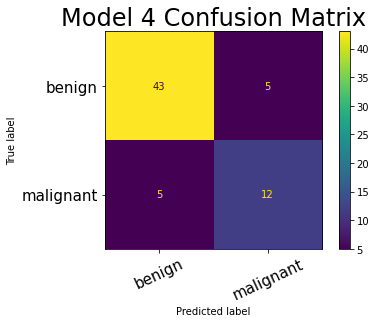

In [ ]:
#confusion matrix 
cm_04=confusion_matrix(y_test_labels, predicted_classes_04)

#plot confusion matrix
display_cm04 = ConfusionMatrixDisplay(cm_04, display_labels=['benign', 'malignant'])
display_cm04.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 4 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [ ]:
#classification report 
print(classification_report(y_test_labels, predicted_classes_04, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.90      0.90      0.90        48
   malignant       0.71      0.71      0.71        17

    accuracy                           0.85        65
   macro avg       0.80      0.80      0.80        65
weighted avg       0.85      0.85      0.85        65



---

## Model 5: 

Models were still showing signs of being overfit, so Model 5 utilized l2 regularization with an added dropout layer at 40%. The optimizer for this model was Adam with a learning rate of 0.0001 and decay of 0.005. Pre-processed image data was input into this model. Initially, I thought this would be the best model. After viewing the classification report, recall was not being optimized even though results were higher. I chose to prioritize recall optimization for this particular problem instead. Results are shown below. 

In [ ]:
#implement pre-built keras network 
conv_base5=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

# adding regularization
regularizer = tf.keras.regularizers.l2(0.001)

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base5.layers:
  layer.trainable=False
  for attr in ['kernel_regularizer']:
        if hasattr(layer, attr):
          setattr(layer, attr, regularizer)

#adding single layer on top of pre-built network 
conv_base5 = Sequential()
conv_base5.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base5.add(Dropout(0.4))
conv_base5.add(Dense(2, activation='sigmoid'))

#compile model 
conv_base5.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, decay=0.005), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history5 = conv_base5.fit(train_batches, 
                               validation_data = val_batches, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

Epoch 1/50
28/28 [==============================] - 39s 1s/step - loss: 4.7561 - accuracy: 0.6483 - recall_10: 0.6069 - val_loss: 1.9174 - val_accuracy: 0.7578 - val_recall_10: 0.7578
Epoch 2/50
28/28 [==============================] - 33s 1s/step - loss: 3.7284 - accuracy: 0.6920 - recall_10: 0.6644 - val_loss: 2.1383 - val_accuracy: 0.7578 - val_recall_10: 0.7578
Epoch 3/50
28/28 [==============================] - 33s 1s/step - loss: 2.6773 - accuracy: 0.7425 - recall_10: 0.7011 - val_loss: 2.6311 - val_accuracy: 0.7578 - val_recall_10: 0.7578
Epoch 4/50
28/28 [==============================] - 33s 1s/step - loss: 2.2611 - accuracy: 0.7816 - recall_10: 0.7586 - val_loss: 2.5806 - val_accuracy: 0.7578 - val_recall_10: 0.7578
Epoch 5/50
28/28 [==============================] - 34s 1s/step - loss: 2.4274 - accuracy: 0.7770 - recall_10: 0.7402 - val_loss: 3.0814 - val_accuracy: 0.7578 - val_recall_10: 0.7578
Epoch 6/50
28/28 [==============================] - 33s 1s/step - loss: 2.0939 -

In [ ]:
#evaluate val 
conv_base5.evaluate(val_batches)

#evaluate test
conv_base5.evaluate(test_batches)

#save model 
conv_base5.save('/content/drive/MyDrive/DSI/05_model')

5/5 [==============================] - 2s 293ms/step - loss: 2.7946 - accuracy: 0.8462 - recall_10: 0.8615


5/5 [==============================] - 2s 330ms/step


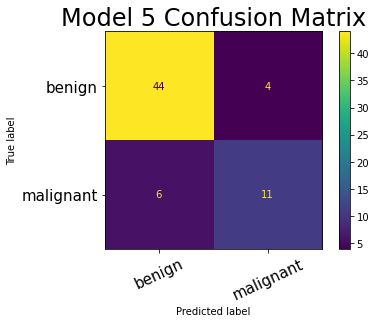

In [ ]:
#test predictions 
y_test=test_batches.labels
preds_05 = conv_base5.predict(test_batches)
predicted_classes_05 = np.argmax(preds_05, axis=1)

#confusion matrix 
cm_05=confusion_matrix(y_test, predicted_classes_05)

#plot confusion matrix
display_cm05 = ConfusionMatrixDisplay(cm_05, display_labels=['benign', 'malignant'])
display_cm05.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 5 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [ ]:
#classification report 
print(classification_report(y_test, predicted_classes_05, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.88      0.92      0.90        48
   malignant       0.73      0.65      0.69        17

    accuracy                           0.85        65
   macro avg       0.81      0.78      0.79        65
weighted avg       0.84      0.85      0.84        65



---

## Model 6: 

Model 6 was the first model ran to correct the output layer mistake shown on the model 1-5 above. I chose to use model 2's framework and change the activation to softmax over sigmoid. SDG optimizer was used with a learning rate of 0.0001 and momentum of 0.9. Model output interpretability was fixed by using softmax activation. Model results are shown below. 

In [ ]:
#implement pre-built keras network 
conv_base6=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base6.layers:
  layer.trainable=False

#adding single layer on top of pre-built network 
conv_base6 = Sequential()
conv_base6.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base6.add(Dense(2, activation='softmax'))

#compile model 
conv_base6.compile(optimizer = tf.keras.optimizers.SGD(learning_rate=0.0001, momentum=0.9), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history6 = conv_base6.fit(train_batches, 
                               validation_data = val_batches, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

94765736/94765736 [==============================] - 3s 0us/step
Epoch 1/50
28/28 [==============================] - 274s 9s/step - loss: 4.4345 - accuracy: 0.6759 - recall: 0.6759 - val_loss: 1.0447 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 2/50
28/28 [==============================] - 37s 1s/step - loss: 2.1169 - accuracy: 0.7057 - recall: 0.7057 - val_loss: 0.6712 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 3/50
28/28 [==============================] - 37s 1s/step - loss: 1.9809 - accuracy: 0.6943 - recall: 0.6943 - val_loss: 0.7364 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 4/50
28/28 [==============================] - 37s 1s/step - loss: 1.7057 - accuracy: 0.7540 - recall: 0.7540 - val_loss: 2.1653 - val_accuracy: 0.2422 - val_recall: 0.2422
Epoch 5/50
28/28 [==============================] - 38s 1s/step - loss: 1.2510 - accuracy: 0.7655 - recall: 0.7655 - val_loss: 1.4819 - val_accuracy: 0.7578 - val_recall: 0.7578
Epoch 6/50
28/28 [==========================

In [ ]:
#evaluate val 
conv_base6.evaluate(val_batches)

#evaluate test
conv_base6.evaluate(test_batches)

# #save model 
conv_base6.save('/content/drive/MyDrive/DSI/06_model')

5/5 [==============================] - 2s 300ms/step - loss: 2.1195 - accuracy: 0.8308 - recall: 0.8308


5/5 [==============================] - 3s 353ms/step


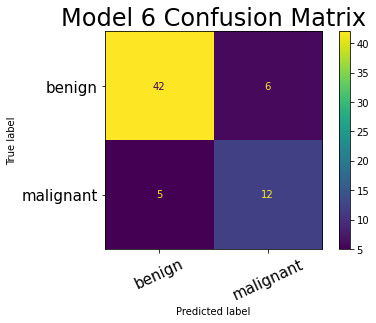

In [ ]:
#test predictions 
y_test=test_batches.labels
preds_06 = conv_base6.predict(test_batches)
predicted_classes_06 = np.argmax(preds_06, axis=1)

#confusion matrix 
cm_06=confusion_matrix(y_test, predicted_classes_06)

#plot confusion matrix
display_cm06 = ConfusionMatrixDisplay(cm_06, display_labels=['benign', 'malignant'])
display_cm06.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 6 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [ ]:
#classification report 
print(classification_report(y_test, predicted_classes_06, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.89      0.88      0.88        48
   malignant       0.67      0.71      0.69        17

    accuracy                           0.83        65
   macro avg       0.78      0.79      0.78        65
weighted avg       0.83      0.83      0.83        65



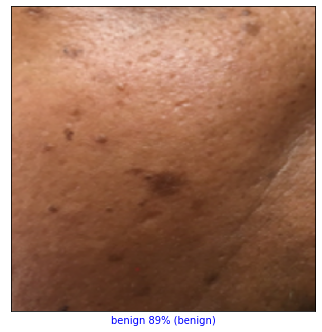

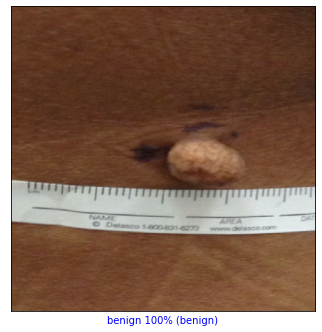

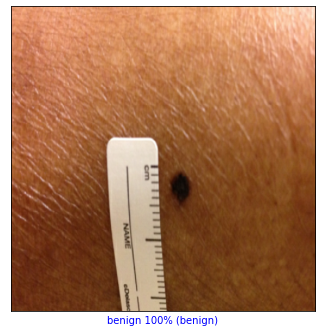

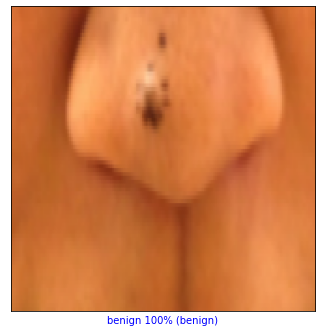

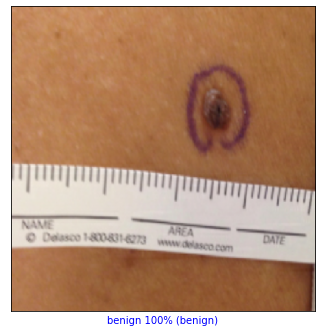

...

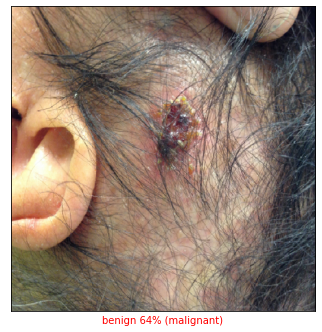

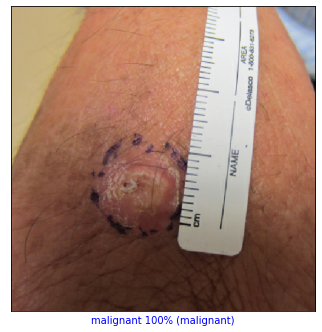

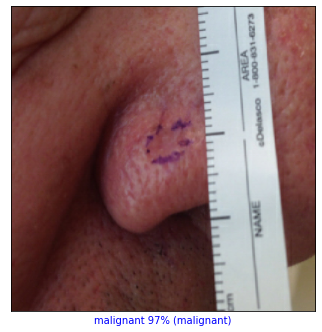

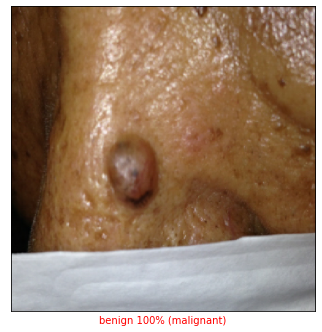

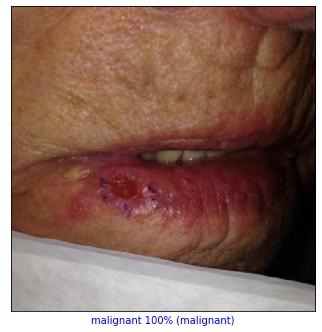

In [ ]:
class_names=['benign', 'malignant']

#calling function 
for i in range(0, len(preds_06+1)):   
  plt.figure(figsize=(12,8))
  plt.subplot(1,2,1)
  plot_post_image(i, preds_06[i], y_test, test_imgs_analysis)
  plt.show()

---

## Model 7:

Model 7 was the second model implemented that used softmax activation over sigmoid. A l2 regularizer and dropout layers at 40% were utilized to try and combat Model 6's overfit-ness. Adam optimizer was used with a learning rate of 0.0001 and decay of 0.005. This model did not optimize for recall, so Model 6 became the best model. 

In [ ]:
#implement pre-built keras network 
conv_base7=ResNet50(input_shape=(512, 512, 3), include_top=False, weights='imagenet')

# adding regularization
regularizer = tf.keras.regularizers.l2(0.001)

#keeps all previous layers frozen and only modifies the top layer 
for layer in conv_base7.layers:
  layer.trainable=False
  for attr in ['kernel_regularizer']:
        if hasattr(layer, attr):
          setattr(layer, attr, regularizer)

#adding single layer on top of pre-built network 
conv_base7 = Sequential()
conv_base7.add(ResNet50(include_top=False, weights='imagenet', pooling='max'))
conv_base7.add(Dropout(0.4))
conv_base7.add(Dense(2, activation='softmax'))

#compile model 
conv_base7.compile(optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, decay=0.005), loss = 'binary_crossentropy', metrics=['accuracy', 
                       tf.keras.metrics.Recall()])

#fit model 
#steps per epoch: train lengh//batch size
#validation steps: val length//batch size 
resnet_history7 = conv_base7.fit(train_batches, 
                               validation_data = val_batches, 
                               steps_per_epoch = 28, 
                               validation_steps= 8,
                               epochs = 50)

Epoch 1/50
28/28 [==============================] - 43s 1s/step - loss: 4.7410 - accuracy: 0.6782 - recall_1: 0.6782 - val_loss: 2.8346 - val_accuracy: 0.7578 - val_recall_1: 0.7578
Epoch 2/50
28/28 [==============================] - 37s 1s/step - loss: 3.3233 - accuracy: 0.7218 - recall_1: 0.7218 - val_loss: 3.9794 - val_accuracy: 0.7578 - val_recall_1: 0.7578
Epoch 3/50
28/28 [==============================] - 37s 1s/step - loss: 2.4388 - accuracy: 0.7954 - recall_1: 0.7954 - val_loss: 2.5875 - val_accuracy: 0.7578 - val_recall_1: 0.7578
Epoch 4/50
28/28 [==============================] - 36s 1s/step - loss: 2.8947 - accuracy: 0.7379 - recall_1: 0.7379 - val_loss: 1.9832 - val_accuracy: 0.7578 - val_recall_1: 0.7578
Epoch 5/50
28/28 [==============================] - 37s 1s/step - loss: 2.0591 - accuracy: 0.8000 - recall_1: 0.8000 - val_loss: 2.6463 - val_accuracy: 0.7578 - val_recall_1: 0.7578
Epoch 6/50
28/28 [==============================] - 36s 1s/step - loss: 2.0742 - accuracy:

In [ ]:
#evaluate val 
conv_base7.evaluate(val_batches)

#evaluate test
conv_base7.evaluate(test_batches)

#save model 
conv_base7.save('/content/drive/MyDrive/DSI/07_model')

5/5 [==============================] - 2s 315ms/step - loss: 3.7223 - accuracy: 0.8462 - recall_1: 0.8462


In [14]:
conv_base7 = tf.keras.models.load_model('/content/drive/MyDrive/DSI/07_model')

5/5 [==============================] - 62s 11s/step


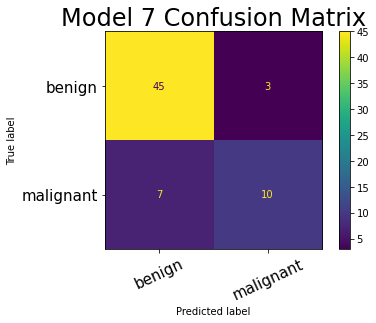

In [15]:
#test predictions 
y_test=test_batches.labels
preds_07 = conv_base7.predict(test_batches)
predicted_classes_07 = np.argmax(preds_07, axis=1)

#confusion matrix 
cm_07=confusion_matrix(y_test, predicted_classes_07)

#plot confusion matrix
display_cm07 = ConfusionMatrixDisplay(cm_07, display_labels=['benign', 'malignant'])
display_cm07.plot(xticks_rotation=25)

# Setting fontsize for xticks and yticks
plt.xticks(fontsize=15)
plt.yticks(fontsize=15)

# Giving name to the plot
plt.title('Model 7 Confusion Matrix', fontsize=24)

# Saving plot
plt.savefig('confusion_matrix.png', transparent=True, dpi=500)

# Showing the plot
plt.show()

In [16]:
#classification report 
print(classification_report(y_test, predicted_classes_07, target_names=['benign', 'malignant']))

              precision    recall  f1-score   support

      benign       0.87      0.94      0.90        48
   malignant       0.77      0.59      0.67        17

    accuracy                           0.85        65
   macro avg       0.82      0.76      0.78        65
weighted avg       0.84      0.85      0.84        65



---
## Next Notebook: Conclusions and Recommendations